# Toronto Housing Price Prediction

The volume of preliminary work this project required amounted to perhaps one of the most challenging yet rewarding experiences I’ve had this summer. Through countless iterations on approach, fetching data, and finalizing model selection to plotting beautiful geomaps, preprocessing, and finally parameters’ tuning, each step produced a POC-like hurdle that took time to overcome but ultimately led to fruitful professional development. Surprisingly, although helpful, a three month data science course I took earlier this year paled in comparison to the growth I experienced spending my Friday nights working on this project in happy solitude.

The deciding factor in terms of subject matter comes from an experience I had last year as a Credit Risk Analyst at a bank. As expected, the role required processing many TFSA, RRSP, investment loan as well as housing applications. It piqued my curiosity into the Ontario housing market, particularly price prediction without manual human involvement. Many questions such as how different areas compare to each other in terms of value, price, demographic distribution, etc, remained unanswered even upon my departure from finance this past year. Since banking institutions have difficulty completely transitioning from their analog/manual past, it ensures working with new, efficient technology an unusual luxury. With my current skillset, I figured I had the tools to attempt a solution.

> Special note: The project was based on the real data that came from the bank's database. In order to avoid any confidentiality issues I have decided to recreate the project and use the similar techniques I used there but with the publicly available data. I took advantage of the Canadian government’s enforcement towards real estate companies to disclose their housing sales to the public. 

Related questions:
- Sources and means to obtain the housing dataset
- Feature engineer new predictors using different sources
- Key insights from current housing market
- ML model selection
- Best approach to hyperparameter optimization

Project’s key takeaways:
- Efficient web scraping
- Self built dataset and feature engineering
- Geographical data visualization
- Standardizing and power transforming the data
- Handling missing data
- Creating custom objectives and evaluations for ML model
- Automatic hyperparameter tuning
- Model averaging and Model Stacking

Datasets:

- Handcrafted housing dataset (time horizon - 1 year)
- Geographical data of GTA neighbourhoods
- Neighbourhood profiles (2 – years old)
- Geographical data of Toronto subway lines/stations


> Limitation: Although the latest Torontonian income level was unavailable, the relational information from the 2017 dataset sufficed.

In [2]:
pip install geopandas

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 1.0 MB 6.0 MB/s 
     |████████████████████████████████| 6.3 MB 52.7 MB/s 
     |████████████████████████████████| 16.7 MB 355 kB/s 


In [3]:
# Load dependencies

import warnings
warnings.filterwarnings('ignore')
import pandas as pd
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import statsmodels.api as sm
import urllib.request
import time
import bs4 as bs
from geopy.geocoders import Nominatim
import geopandas as gpd
import seaborn as sns
from scipy import stats

# To make pyproj conversions work
import os 
os.environ['PROJ_LIB']=r"C:\Users\spiris\AppData\Local\Continuum\anaconda3\Library\share"

# Obtaining housing data

### Save all search results

The Zoocasa API was selected as the resource due to it’s efficient search on currently listed and previously sold properties, albeit the data lacked granularity. The pricing data collection process included the following: 
1. A search was placed 
2. The page was converted to string format 
3. All search results represented through links were extracted to a ‘house_links’ file. This gave way to easily tracking the results by conveniently looping through the extracted list.

In [5]:
total_pages = 731
links = pd.DataFrame(columns=['link'])
links_done = 0


for page in range(1,(total_pages + 1)):
    
    user_agent = 'Mozilla/5.0 (Windows; U; Windows NT 5.1; en-US; rv:1.9.0.7) Gecko/2009021910 Firefox/3.0.7'
    url = "https://www.zoocasa.com/toronto-on-sold-listings?page=" + str(page)
    headers={'User-Agent':user_agent,} 

    request=urllib.request.Request(url,None,headers) #The assembled request
    data_raw = urllib.request.urlopen(request).read()
    data_split = data_raw.split(b'/listing-status>')[1:]
    time.sleep(1)
    
    for post in range(24): 

        try:
            start = data_split[post].find(b'href="/')
            end = data_split[post].find(b'-vow"')
            links.loc[links_done] = data_split[post][(start+7):(end+4)]

            links_done += 1
            links.to_csv('house_links.csv')

SyntaxError: ignored

In [6]:
# Prepare a table for data population

links = pd.read_csv('house_links.csv', index_col='Unnamed: 0')
data = pd.DataFrame(columns=['title','final_price', 'list_price','bedrooms','bathrooms','sqft','parking','description','mls','type','full_link','full_address', 'lat', 'long', 'city_district'])

### Data enrichment
Looping through the generated list of links and extracting such information as:

**Title, MSL number, Type of property, Final price, Listed price, Bedrooms, Bathrooms, Sqft, Parking, Description, Exact address**

In [7]:
start_time = time.time()
skipped = []
house_length = links.shape[0]

for no in range(house_length):
    try:
        url = 'https://www.zoocasa.com/' + str(links.link[no])[2:-1]

        #read data, convert to 2 formats
        request=urllib.request.Request(url,None,headers) #The assembled request
        data_raw = urllib.request.urlopen(request).read()
        soup = bs.BeautifulSoup(data_raw, 'lxml')

        #full link
        data.loc[no,'full_link'] = url

        #title
        data.loc[no,'title'] = soup.title.contents[0]

        #MLS
        mls_a = data_raw.find(b'Number</span>\n            <span>')
        mls_b = data_raw[(mls_a+32):].find(b'</span>')
        data.loc[no,'mls'] = data_raw[(mls_a+32):((mls_a+mls_b+32))]

        #Type
        type_a = data_raw.find(b'Type</span>\n            <span>')
        type_b = data_raw[(type_a+30):].find(b'</span>')
        data.loc[no,'type'] = data_raw[(type_a+30):((type_a+type_b+30))]

        #the rest
        table_html = soup.findAll("span", {"class": "blur"})
        for n,c in enumerate(['final_price', 'list_price','bedrooms','bathrooms','sqft','parking','description']):
            data.loc[no, c] = table_html[n].contents[0]

        #location data
        address = soup.title.contents[0]
        address = address.replace('Circ', 'Cir') #edit #1
        address_b = address.find('(')
        address_a = address.find('-')
        
        data.loc[no,'full_address'] = address[(address_a+1):address_b]

#         location = geolocator.geocode(address[(address_a+1):address_b], timeout = 3, addressdetails=True)
#         data.loc[no,'full_address'] = location.address
#         data.loc[no,'lat'] = location.latitude
#         data.loc[no,'long'] = location.longitude
#         try: data.loc[no,'city_district'] = location.raw['address']['city_district']
#         except:data.loc[no,'city_district'] = location.raw['address']['city']


        #pause and print
        time.sleep(1)
        if no % 10 == 0: print(no, 'is done')
    
    except: 
        print('Problem with: ', no)
        skipped.append(no)
        continue
    
print('Skipped: ', skipped, ', Total: ', len(skipped))
print('Total time: %.2f' % (time.time() - start_time))

data.to_excel('data.xlsx')

Streaming output truncated to the last 5000 lines.
Problem with:  12546
Problem with:  12547
Problem with:  12548
Problem with:  12549
Problem with:  12550
Problem with:  12551
Problem with:  12552
Problem with:  12553
Problem with:  12554
Problem with:  12555
Problem with:  12556
Problem with:  12557
Problem with:  12558
Problem with:  12559
Problem with:  12560
Problem with:  12561
Problem with:  12562
Problem with:  12563
Problem with:  12564
Problem with:  12565
Problem with:  12566
Problem with:  12567
Problem with:  12568
Problem with:  12569
Problem with:  12570
Problem with:  12571
Problem with:  12572
Problem with:  12573
Problem with:  12574
Problem with:  12575
Problem with:  12576
Problem with:  12577
Problem with:  12578
Problem with:  12579
Problem with:  12580
Problem with:  12581
Problem with:  12582
Problem with:  12583
Problem with:  12584
Problem with:  12585
Problem with:  12586
Problem with:  12587
Problem with:  12588
Problem with:  12589
Problem with:  12590
Prob

In [8]:
houses = pd.read_excel('data.xlsx', index_col=0)

# Adding province name and country to be precise
houses[['full_address']] = houses[['full_address']].astype(str) + ', Ontario, Canada'
houses.head(2)

,title,final_price,list_price,bedrooms,bathrooms,sqft,parking,description,mls,type,full_link,full_address,lat,long,city_district


Any record missing the final price was removed (also it is the response variable); the latest record was chosen for those that had multiple prices. The final prices will be processed and converted from string to integer format.

In [9]:
print('Data shape before procedure: ', houses.shape)

houses.dropna(subset=['final_price'], inplace=True)
houses.drop_duplicates(subset=['mls'], inplace=True)

print('Data shape after procedure: ', houses.shape)

for column in ['final_price', 'list_price']:
    houses[column] = houses[column].apply(lambda b: b.replace(',', '').replace('$', '')).astype('int32')

Data shape before procedure:  (0, 15)
Data shape after procedure:  (0, 15)


Some data points with missing addresses were patched by leveraging the **title** column.

In [10]:
trouble_addresses = houses[houses.full_address == 'nan, Ontario, Canada'].index
print(trouble_addresses)

for address_index in trouble_addresses.tolist():
    address = houses.loc[address_index, 'title']
    address_a = address.find('(')
    houses.loc[address_index,'full_address'] = address[:(address_a-1)] + str(', Ontario, Canada')

Index([], dtype='object')


In order to assign geographic coordinates to each property, geolocation data was extracted from the **Google API**.

In [11]:

# VIA GEOLOCATOR
# for row, value in houses.iterrows():
#     if pd.isnull(houses.loc[row, 'lat']):
#         try:
#             location = geolocator.geocode(houses.loc[row, 'full_address'], timeout = 3, addressdetails=True)
#             houses.loc[row,'lat'] = location.latitude
#             houses.loc[row,'long'] = location.longitude
#             time.sleep(1.5)
#         except: 
#             print(row, 'SKIPPED')
#         if row % 20 == 0 : print(row, ' done')
#         if row == 100: break
            

# VIA GOOGLE API
import googlemaps
from datetime import datetime
gmaps = googlemaps.Client(key='MY_KEY')

for row, value in houses.iterrows():
    try:
        geocode_result = gmaps.geocode(houses.loc[row, 'full_address'])
        houses.loc[row,'lat'] = geocode_result[0]['geometry']['location']['lat']
        houses.loc[row,'long'] = geocode_result[0]['geometry']['location']['lng']
    except: 
        print(row, 'SKIPPED')
        
houses.to_csv('houses.csv')

ModuleNotFoundError: ignored

Next step: Obtaining neighbourhood locations and shapes from Open Data Portal and converting them from their original Shapefile format to a more manageable one.

Using **EPSG:4269** (Lat, Long format) in this case we’ll ensure that the coordinates align for both areas and properties.

In [ ]:
# Read districts geo data
# https://open.toronto.ca/dataset/neighbourhoods/
# https://open.toronto.ca/dataset/neighbourhood-profiles/
t_geodata = gpd.read_file('datasets/opendata_neighbourhoods/Neighbourhoods.shp')

# rename columns
t_geodata_columns = pd.read_csv('datasets/opendata_neighbourhoods/Neighbourhoods_fields.csv')
t_geodata.columns = t_geodata_columns.name.values

# Convert data to lat, long type
t_geodata['geometry'] = t_geodata['geometry'].to_crs({'init': 'EPSG:4269'})

In [ ]:
houses = pd.read_csv('houses.csv', index_col='index')
houses = houses.dropna(subset=['city_district'])
houses.drop(index=[14, 14388], inplace=True)

print(houses.shape)

(15234, 17)


The Bokeh library provided high-resolution interactive geomaps thereby making it the ideal tool to validate and visualize our geodata. 

>Bokeh is an interactive visualization library that targets modern web browsers for presentation. Its goal is to provide elegant, concise construction of versatile graphics, and to extend this capability with high-performance interactivity over very large or streaming datasets. Bokeh can help anyone who would like to quickly and easily create interactive plots, dashboards, and data applications.

In [ ]:
import json
from bokeh.io import output_notebook, show, output_file
from bokeh.plotting import figure
from bokeh.models import GeoJSONDataSource, LinearColorMapper, ColorBar

#Read data to json.
t_geodata_json = json.loads(t_geodata.to_json())

#Convert to String like object.
json_data = json.dumps(t_geodata_json)

#Input GeoJSON source that contains features for plotting.
geosource = GeoJSONDataSource(geojson = json_data)

p = figure(title = 'GTA neighbourhoods', plot_height = 600 , plot_width = 950)
p.xgrid.grid_line_color = None
p.ygrid.grid_line_color = None

#Add patch renderer to figure. 
p.patches('xs','ys', source = geosource,
          line_color = 'white', line_width = 0.25, fill_alpha = 1)

#Display figure in Jupyter Notebook.
output_notebook()
#Display figure.
show(p)

Loading BokehJS ...

The third dataset representing neighbourhood data, was more detailed than expected. Education, ethnicity, immigration /citizenship, income, population, etc.. Only income data and area codes/names will be required.

In [ ]:
#get Toronto neighbourhood data and extract district codes with their average incomes
t_data = pd.read_csv('datasets/opendata_neighbourhoods/neighbourhood-profiles-2016-csv.csv', )
# Potential Income prospects, ids: 1030, 2273, 2274

t_income = t_data[(t_data.Characteristic == 'Neighbourhood Number') | (t_data.Characteristic == 'Total income: Average amount ($)')]
t_income = t_income.T.reset_index()
t_income.columns = ['area', 'area_code', 'average_income']
t_income = t_income.iloc[6:,:]
print(t_income.head())
print('-' * 60)

#Looks like we need to convert income and area code columns into integers
print(t_income.info())
print('-' * 60)
t_income['average_income'] = t_income['average_income'].apply(lambda a: a.replace(',','')).astype('int64')
t_income['area_code'] = t_income['area_code'].astype('int64')
print(t_income.info())
print('-' * 60)

# Calculate incoem mean
mean_t_income = t_income['average_income'].mean()
print('GTA mean income: ',mean_t_income)

                            area area_code average_income
6                Agincourt North       129         30,414
7   Agincourt South-Malvern West       128         31,825
8                      Alderwood        20         47,709
9                          Annex        95        112,766
10             Banbury-Don Mills        42         67,757
------------------------------------------------------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 140 entries, 6 to 145
Data columns (total 3 columns):
area              140 non-null object
area_code         140 non-null object
average_income    140 non-null object
dtypes: object(3)
memory usage: 3.4+ KB
None
------------------------------------------------------------
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 140 entries, 6 to 145
Data columns (total 3 columns):
area              140 non-null object
area_code         140 non-null int64
average_income    140 non-null int64
dtypes: int64(2), object(1)
memory usage: 3.4+ KB
N

Finally, let’s merge neighbourhood profiles with their appropriate geolocations.

In [ ]:
# Merge districts geodata and Toronto income

all_t_data = t_geodata.merge(t_income, left_on='AREA_SHORT_CODE', right_on='area_code')
useless_columns_all_t_data = ['_id', 'AREA_ID', 'AREA_ATTR_ID', 'PARENT_AREA_ID', 'AREA_SHORT_CODE', 'AREA_LONG_CODE',
                             'AREA_NAME', 'AREA_DESC', 'X', 'Y']
all_t_data.drop(useless_columns_all_t_data, axis=1, inplace=True)
all_t_data.head()

,LONGITUDE,LATITUDE,OBJECTID,Shape__Area,Shape__Length,geometry,area,area_code,average_income
0,-79.425515,43.676919,16491505,3.217960e+06,7515.779658,POLYGON ((-79.43591570873059 43.68015339477484...,Wychwood,94,54460
1,-79.403590,43.704689,16491521,3.160334e+06,7872.021074,POLYGON ((-79.41095783825973 43.70408282301482...,Yonge-Eglinton,100,89330
2,-79.397871,43.687859,16491537,2.222464e+06,8130.411276,POLYGON ((-79.39119482591805 43.68108112277793...,Yonge-St.Clair,97,114174
3,-79.488883,43.765736,16491553,2.541821e+07,25632.335242,POLYGON ((-79.50528791818931 43.75987349878096...,York University Heights,27,29958
4,-79.457108,43.714672,16491569,1.156669e+07,13953.408098,"POLYGON ((-79.4396873322608 43.70560981891119,...",Yorkdale-Glen Park,31,38527


Each house in the dataset requires a mean income and area name assigned to it. To achieve this each house is crosschecked by being projected on the map. 

Some areas that do not belong anywhere also lie beyond our target map. After careful considerations, I’ve decided that these areas are outside of the project scope and could be safely removed.

In [ ]:
from shapely.geometry import Point, Polygon

def find_district(point, df):
    '''
    Returns District name, Area code, and District average income
    '''

    in_shape = []
    for sh in df.geometry:
        within = point.within(sh)
        in_shape.append(within)
    return df.loc[in_shape.index(True), 'area'], df.loc[in_shape.index(True), 'area_code'], df.loc[in_shape.index(True), 'average_income']


houses['mean_district_income'] = 0
houses['district_code'] = 0

not_assigned = []
for row, value in houses.iterrows():
    try:
        result = find_district(Point(houses.loc[row, 'long'], houses.loc[row, 'lat']), all_t_data)
        houses.loc[row, 'city_district'] = result[0]
        houses.loc[row, 'mean_district_income'] = result[2]
        houses.loc[row, 'district_code'] = result[1]
        time.sleep(0.1)
    except:
        not_assigned.append(row)
        
# Not assigned houses
print(not_assigned)

[353, 546, 623, 823, 953, 966, 1013, 1223, 1291, 1515, 1860, 2091, 2163, 2269, 2284, 2445, 2630, 3259, 3693, 3729, 4313, 4624, 4634, 4818, 4840, 4990, 5021, 5087, 5114, 5174, 5274, 5618, 5834, 5867, 5933, 6281, 6355, 6378, 6473, 6603, 6677, 6678, 6695, 7066, 7087, 7179, 7186, 7357, 7802, 7909, 8069, 8436, 8458, 8540, 8657, 8685, 8810, 8872, 8887, 9082, 9096, 9344, 9345, 9346, 9390, 9730, 9822, 9879, 9922, 9924, 9973, 9988, 10046, 10047, 10161, 10301, 10340, 10426, 10574, 10760, 10799, 10835, 11080, 11083, 11088, 11221, 11596, 11605, 11650, 11750, 11796, 11834, 12013, 12623, 12906, 13012, 13116, 13389, 13606, 13972, 13978, 13992, 14071, 14105, 14343, 14728, 14777, 14923, 15168, 15203, 15402, 15476, 15501, 15603, 16235, 16382, 16583, 16623, 16645, 16666, 16761, 17042, 17192, 17257, 17449]


# Data Exploration

Finally, let’s examine the data. 

In the example below we can clearly see our Prices and Income data are very positively skewed which probably affect results on the map. (The data has many outliers => many colours wouldn't even be shown on the map). Out of the available **Bokeh** or **Seaborne** options I decided to explore the **scipy.stats** package in order to find an appropriate power transformer. 

Log transform is an excellent method to convert positively skewed data into normal, but here I mainly focused on automatic power conversion named Boxcox.

> A Box Cox transformation is a way to transform non-normal dependent variables into a normal shape. Normality is an important assumption for many statistical techniques; if your data isn’t normal, applying a Box-Cox means that you are able to run a broader number of tests.
The Box Cox transformation is named after statisticians George Box and Sir David Roxbee Cox who collaborated on a 1964 paper and developed the technique.



<center>The one-parameter Box–Cox transformations are defined as:</center>

<img src="img/boxcox.svg" alt="Drawing"/>

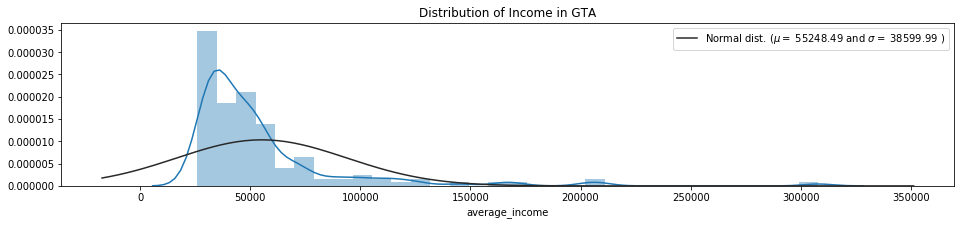

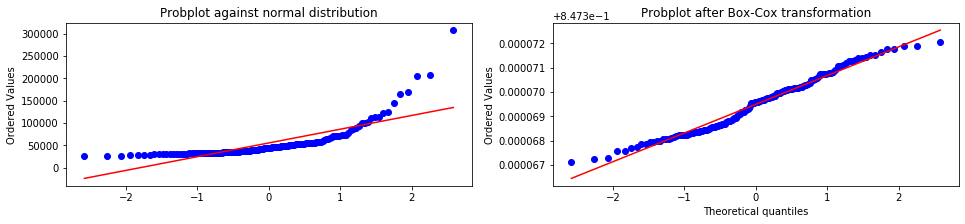

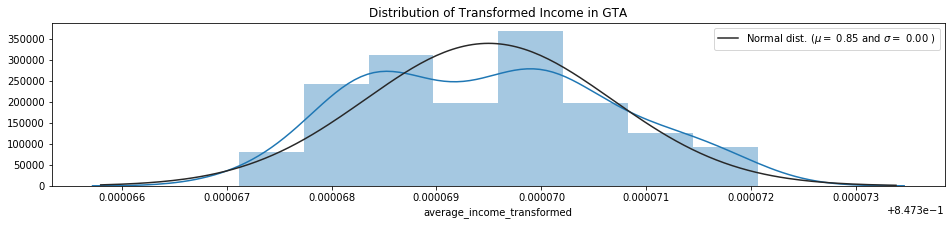

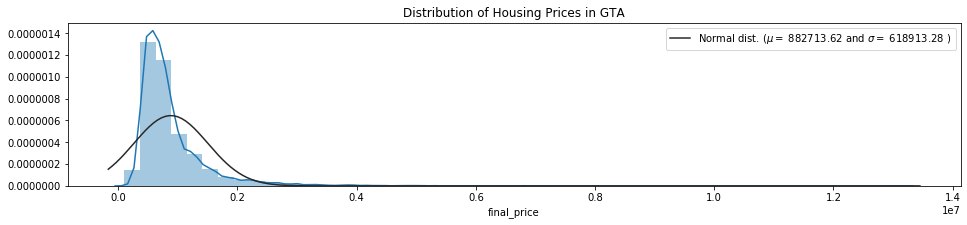

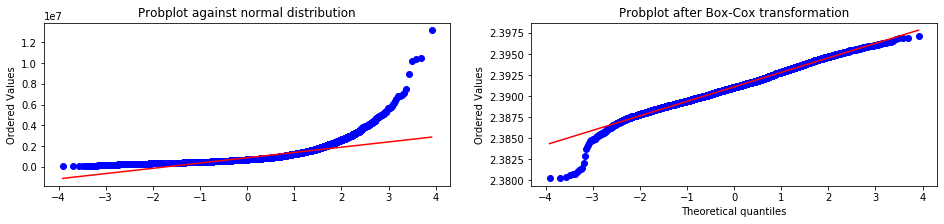

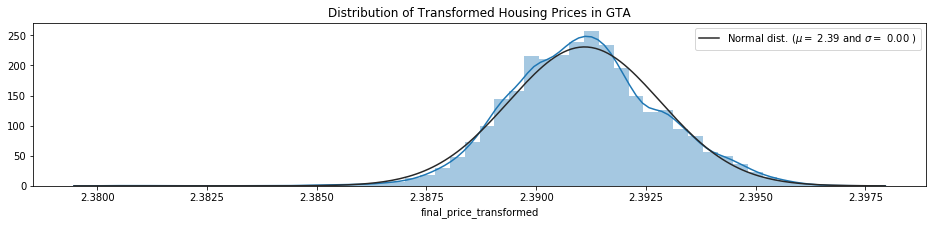

In [ ]:
plt.figure(1, figsize=[16,3])

plt.subplots_adjust(hspace=0.4)
sns.distplot(all_t_data['average_income'], fit=stats.norm)
plt.title('Distribution of Income in GTA')
(mu, sigma) = stats.norm.fit(all_t_data['average_income'])
plt.legend(['Normal dist. ($\mu=$ {:.2f} and $\sigma=$ {:.2f} )'.format(mu, sigma)],
            loc='best')

plt.figure(2, figsize=[16,3])

ax1=plt.subplot(1,2,1)
x = all_t_data['average_income']
stats.probplot(x, dist=stats.norm, plot=ax1)
ax1.set_xlabel('')
ax1.set_title('Probplot against normal distribution')


ax2=plt.subplot(1,2,2)
boxcox_lambda = stats.boxcox_normmax(x, brack=(-1.9, 2.0),  method='mle')
transformed_array = stats.boxcox(x, boxcox_lambda)
# To transform back
# np.exp(np.log(boxcox_lambda*transformed_array+1)/boxcox_lambda)
stats.probplot(transformed_array, dist=stats.norm , plot=ax2)
ax2.set_title('Probplot after Box-Cox transformation')
all_t_data['average_income_transformed'] = transformed_array

plt.figure(3, figsize=[16,3])
sns.distplot(all_t_data['average_income_transformed'], fit=stats.norm)
plt.title('Distribution of Transformed Income in GTA')
(mu, sigma) = stats.norm.fit(all_t_data['average_income_transformed'])
plt.legend(['Normal dist. ($\mu=$ {:.2f} and $\sigma=$ {:.2f} )'.format(mu, sigma)],
            loc='best')

plt.figure(4, figsize=[16,3])

sns.distplot(houses['final_price'], fit=stats.norm)
plt.title('Distribution of Housing Prices in GTA')
(mu, sigma) = stats.norm.fit(houses['final_price'])
plt.legend(['Normal dist. ($\mu=$ {:.2f} and $\sigma=$ {:.2f} )'.format(mu, sigma)],
            loc='best')

plt.figure(5, figsize=[16,3])

ax3=plt.subplot(1,2,1)
x = houses['final_price']
stats.probplot(x, dist=stats.norm, plot=ax3)
ax3.set_xlabel('')
ax3.set_title('Probplot against normal distribution')


ax4=plt.subplot(1,2,2)
boxcox_lambda = stats.boxcox_normmax(x, brack=(-1.9, 2.0),  method='mle')
transformed_array = stats.boxcox(x, boxcox_lambda)
stats.probplot(transformed_array, dist=stats.norm , plot=ax4)
ax4.set_title('Probplot after Box-Cox transformation')
houses['final_price_transformed'] = transformed_array

plt.figure(6, figsize=[16,3])
sns.distplot(houses['final_price_transformed'], fit=stats.norm)
plt.title('Distribution of Transformed Housing Prices in GTA')
(mu, sigma) = stats.norm.fit(houses['final_price_transformed'])
plt.legend(['Normal dist. ($\mu=$ {:.2f} and $\sigma=$ {:.2f} )'.format(mu, sigma)],
            loc='best')


all_t_data['average_income_log']= np.log(all_t_data['average_income'])
houses['final_price_log']= np.log(houses['final_price'])

plt.show()

With the normalized data, we’re ready to plot them and analyze how they relate to each other.

In [ ]:
from bokeh.palettes import brewer
from bokeh.models import Label, HoverTool, AjaxDataSource

#Read data to json.
t_geodata_json = json.loads(all_t_data.to_json())

#Convert to String like object.
json_data = json.dumps(t_geodata_json)


#Input GeoJSON source that contains features for plotting.
geosource = GeoJSONDataSource(geojson = json_data)

#Add hover tool
hover = HoverTool(tooltips = [ ('District','@area'),('Average Income', '@average_income')])


p = figure(title = 'GTA Neighbourhood Income', plot_height = 600 , plot_width = 950, tools = [hover])
p.xgrid.grid_line_color = None
p.ygrid.grid_line_color = None


# Add patch renderer to figure. 
palette = brewer['Spectral'][11] #[::-1]
color_mapper = LinearColorMapper(palette = palette,
                                 low = all_t_data['average_income_transformed'].min(),
                                 high = all_t_data['average_income_transformed'].max())

p.patches('xs','ys', source = geosource,
          line_color = 'white', line_width = 0.25, fill_alpha = 1,
         fill_color = {'field' :'average_income_transformed', 'transform' : color_mapper})


#Display figure in Jupyter Notebook.
output_notebook()
#Display figure.
show(p)

Loading BokehJS ...

Applying housing data to the map.

You can see two levels:

- Bottom level represents the districts and average annual wages in the areas.
- Medium level represents the Toronto subway lines and stations
- Top above represents housing prices

In [ ]:
# upload TTC stations and lines
slines_geodata = gpd.read_file('datasets/transit/TTC_SubwayLines_20120119/subwayLines.shp')
sstations_geodata = gpd.read_file('datasets/transit/TTC_SubwayStns_20120119/subwayStations.shp')

slines_geodata['colors'] = ['limegreen', 'plum', 'dodgerblue', 'gold']

for dataset in [slines_geodata, sstations_geodata]:
    dataset['geometry'] = dataset['geometry'].to_crs({'init': 'EPSG:4269'})
    
slines_geodata

,LINE,SHAPE_Leng,geometry,colors
0,Bloor-Danforth,26377.465093,LINESTRING (-79.53583252791701 43.637344929293...,limegreen
1,Sheppard,5431.438569,LINESTRING (-79.41093973913846 43.761511343379...,plum
2,TransferTunnel,351.921082,LINESTRING (-79.40526716250963 43.670320450279...,dodgerblue
3,Yonge-University-Spadina,30085.504598,(LINESTRING (-79.37749782512772 43.64819268859...,gold


In [ ]:
from bokeh.models.glyphs import MultiLine
from bokeh.models import Cross,NumeralTickFormatter

# Input GeoJSON source that contains features for plotting.
geosource = GeoJSONDataSource(geojson = all_t_data.to_json())
slines_source = GeoJSONDataSource(geojson = slines_geodata.to_json())
sstation_source = GeoJSONDataSource(geojson = sstations_geodata.to_json())

p = figure(title = 'GTA housing prices projected on average district wages', plot_height = 680 , plot_width = 950,
          active_scroll='wheel_zoom')
p.xgrid.grid_line_color = None
p.ygrid.grid_line_color = None


# Add patch renderer to figure - Areas and Average Income. 
palette_1 = brewer['RdBu'][11] #[::-1]
color_mapper_1 = LinearColorMapper(palette = palette_1,
                                 low = all_t_data['average_income_log'].min(),
                                 high = all_t_data['average_income_log'].max())

p.patches('xs','ys', source = geosource,
          line_color = 'white', line_width = 0.25, fill_alpha = 0.7,
         fill_color = {'field' :'average_income_log', 'transform' : color_mapper_1})

#Add subway lines
p.multi_line('xs', 'ys', source=slines_source, color='colors', line_width=2.5)


#Define custom tick labels for color bar.
tick_labels = {'10': '22K','10.5':'35K','11':'60K','11.5':'100k', '12':'162K', '12.5':'268k'}

#Create color bar 1. 
color_bar_1 = ColorBar(color_mapper=color_mapper_1, label_standoff=8,width = 500, height = 15,
border_line_color=None,location = (0,0), orientation = 'horizontal', major_label_overrides = tick_labels)

#Specify figure layout.
p.add_layout(color_bar_1, 'below')


# Add houses to the map
palette = brewer['Spectral'][11] #[::-1]
color_mapper = LinearColorMapper(palette = palette,
                                 low = houses['final_price_log'].min(),
                                 high = houses['final_price_log'].max())

geosource_2 = AjaxDataSource(houses)
p1 = p.circle('long', 'lat', alpha=0.3, radius=0.0006, color={'field': 'final_price_log', 'transform': color_mapper}, source=geosource_2)



#Define custom tick labels for color bar.
tick_labels = {'12': '160K','13':'440K','14':'1,200K','15':'3,270k', '16':'8,890K'}

#Create color bar 2. 
color_bar = ColorBar(color_mapper=color_mapper, label_standoff=8,width = 500, height = 15,
border_line_color=None,location = (0,0), orientation = 'horizontal', major_label_overrides = tick_labels)


#Add hover tool
hover = HoverTool(renderers=[p1],
                     tooltips =[('District','@city_district'),
                               ('District Income', '$ @mean_district_income{0,0}'), 
                               ('Price','$ @final_price{0,0}'),
                               ('Type', '@type'),
                               ('MLS','@mls')])
p.add_tools(hover)

#Specify figure layout.
p.add_layout(color_bar, 'below')

# Add subway stations
p.circle('x', 'y', source=sstation_source, radius=0.001, color="white", line_color='black', line_width=0.3)

#Display figure in Jupyter Notebook.
output_notebook()

#Display figure.
show(p)

Loading BokehJS ...

In [ ]:
from bokeh.models.glyphs import MultiLine
from bokeh.models import Cross,NumeralTickFormatter

#Input GeoJSON source that contains features for plotting.
geosource = GeoJSONDataSource(geojson = all_t_data.to_json())
p = figure(title = 'GTA housing prices projected on average district wages', plot_height = 680 , plot_width = 950,
          active_scroll='wheel_zoom')
p.xgrid.grid_line_color = None
p.ygrid.grid_line_color = None


# Add patch renderer to figure - Areas and Average Income. 
palette_1 = brewer['RdBu'][11] #[::-1]
color_mapper_1 = LinearColorMapper(palette = palette_1,
                                 low = all_t_data['average_income_log'].min(),
                                 high = all_t_data['average_income_log'].max())

p.patches('xs','ys', source = geosource,
          line_color = 'white', line_width = 0.25, fill_alpha = 0.7,
         fill_color = {'field' :'average_income_log', 'transform' : color_mapper_1})



#Define custom tick labels for color bar.
tick_labels = {'10': '22K','10.5':'35K','11':'60K','11.5':'100k', '12':'162K', '12.5':'268k'}

#Create color bar 1. 
color_bar_1 = ColorBar(color_mapper=color_mapper_1, label_standoff=8,width = 500, height = 15,
border_line_color=None,location = (0,0), orientation = 'horizontal', major_label_overrides = tick_labels)

#Specify figure layout.
p.add_layout(color_bar_1, 'below')




# Add houses to the map
palette = brewer['Spectral'][11] #[::-1]
color_mapper = LinearColorMapper(palette = palette,
                                 low = houses['final_price_log'].min(),
                                 high = houses['final_price_log'].max())

geosource_2 = AjaxDataSource(houses)
p1 = p.circle('long', 'lat', alpha=0.3, radius=0.0007, color={'field': 'final_price_log', 'transform': color_mapper}, source=geosource_2)


#Define custom tick labels for color bar.
tick_labels = {'12': '160K','13':'440K','14':'1,200K','15':'3,270k', '16':'8,890K'}

#Create color bar 2. 
color_bar = ColorBar(color_mapper=color_mapper, label_standoff=8,width = 500, height = 15,
border_line_color=None,location = (0,0), orientation = 'horizontal', major_label_overrides = tick_labels)


# Add hover tool
hover = HoverTool(renderers=[p1],
                     tooltips =[('District','@city_district'),
                               ('District Income', '$ @mean_district_income{0,0}'), 
                               ('Price','$ @final_price{0,0}'),
                               ('Type', '@type'),
                               ('MLS','@mls')])
p.add_tools(hover)

#Specify figure layout.
p.add_layout(color_bar, 'below')


#Display figure in Jupyter Notebook.
output_notebook()

#Display figure.
show(p)

Feel free to hover over the points to see detailed information. You can also visit Zoocasa and look up any apartment by MLS number yourself.

Based on the plot there are a few important observations to be made:

- Average income and final price correlate with each other
- A majority of the Condo apartments (mostly green), are concentrated downtown and across subway lines towards North York. (500k to 700k)
- A majority of the areas in yellow/red are restricted to detached houses. For which the price varies between 800k and 1,500k
- Logically, a disproportionately high number of condos were sold in the downtown area than any other
- A majority of low-income areas like Scarborough have Co-op Apartments and Condos within 200k - 400k range
Top three earners/Most-expensive properties: York Mills, Rosedale-Moore Park, Forest Hill South



Out of curiosity I inspected some of these expensive properties.

<tr>
<td> <img src="img/C4466546_1.JPG" alt="Drawing"  /> </td>
<td> <img src="img/C4423456.JPG" alt="Drawing"  /> </td>
</tr>

<tr>
<td> <img src="img/C4333829.JPG" alt="Drawing"  /> </td>
<td> <img src="img/C4511555.JPG" alt="Drawing"  /> </td>
</tr>

# Further analysis and transformations

Objectives:
1.	Split Bedroom feature between Above Grade(bedrooms_ag) and Below Grade(bedrooms_bg). Bedrooms above grade might be more valuable than below grade
2.	Create a max cap for parking
3.	Convert square footage to integers
4.	Merge minor group types

In [ ]:
# Before we make any transformations to our data let's make a copy
houses_edited = houses.copy() 

def convert_bedrooms(n_plus_n, above = True):
    removed_beds_str = n_plus_n.replace(' beds', '')
    
    if above == True:
        return int(removed_beds_str[0])
    else:
        if len(removed_beds_str) > 2:
            return int(removed_beds_str[-1])
        else: return 0
        
        
def convert_parking(parking):
    parking = int(parking.replace(' parking', '').replace('no', '0'))
    if parking > 10:
        return 11
    else: return parking
    
    
def convert_sqft(value):
    value = value.replace(' sq. ft.', '').replace('0-499', '0–499')   
    value = value.split('–')
    try: return (int(value[0]) + int(value[1]))/2     
    except: 0
    
    
houses_edited['bedrooms_ag'] = houses_edited.bedrooms.apply(convert_bedrooms)
houses_edited['bedrooms_bg'] = houses_edited.bedrooms.apply(convert_bedrooms, above = False)
houses_edited.bathrooms = houses_edited.bathrooms.apply(lambda a: int(a.replace(' baths', '')))
houses_edited.parking = houses_edited.parking.apply(convert_parking)
houses_edited.sqft = houses_edited.sqft.apply(convert_sqft).round(0)

houses_edited.type.replace({
    'Duplex': 'Plex',
    'Triplex': 'Plex',
    'Fourplex': 'Plex',
    'Multiplex': 'Plex',
    'Det Condo': 'Condo Apt',
    'Leasehold Condo': 'Condo Apt'   
}, inplace=True)

houses_edited.to_csv('houses_edited.csv')
houses_edited.head(2)

,title,final_price,list_price,bedrooms,bathrooms,sqft,parking,description,mls,type,...,full_address,lat,long,city_district,mean_district_income,district_code,final_price_transformed,final_price_log,bedrooms_ag,bedrooms_bg
index,,,,,,,,,,,,,,,,,,,,,
0,"1303 - 38 Grenville St, Toronto (C4461599) | Z...",855000,870000,2 + 1 beds,2,850.0,1,"Luxurious And Spacious Murano Tower. 2+1, 2 Ba...",C4461599,Condo Apt,...,"38 Grenville St, Toronto , Ontario, Canada",43.661896,-79.385748,Bay Street Corridor,56526,76,2.391687,13.658857,2,1
1,"2 Cabot Crt, Toronto (W4502992) | Zoocasa",885000,898000,3 beds,2,NaN,6,Fantastic Opportunity To Live Within The Histo...,W4502992,Semi-Detached,...,"2 Cabot Crt, Toronto , Ontario, Canada",43.646982,-79.530356,Islington-City Centre West,52787,14,2.391803,13.693343,3,0


Create dummy columns for categorical variables  

In [ ]:
houses_edited = pd.read_csv('houses_edited.csv', index_col='index')
needed_columns = ['sqft', 'parking' , 'mean_district_income', 'bedrooms_ag', 'bedrooms_bg', 'type', 'final_price']


# houses_edited.info()
houses_dummies = pd.get_dummies(houses_edited[needed_columns])
predictors = houses_dummies.drop('final_price', axis=1).columns
houses_dummies.head(5)

,sqft,parking,mean_district_income,bedrooms_ag,bedrooms_bg,final_price,type_Att/Row/Twnhouse,type_Co-Op Apt,type_Co-Ownership Apt,type_Comm Element Condo,type_Condo Apt,type_Condo Townhouse,type_Detached,type_Link,type_Plex,type_Semi-Detached,type_Store W/Apt/Offc
index,,,,,,,,,,,,,,,,,
0,850.0,1,56526,2,1,855000,0,0,0,0,1,0,0,0,0,0,0
1,NaN,6,52787,3,0,885000,0,0,0,0,0,0,0,0,0,1,0
2,550.0,0,57039,1,0,550000,0,0,0,0,1,0,0,0,0,0,0
3,650.0,1,70623,1,1,665000,0,0,0,0,1,0,0,0,0,0,0
4,NaN,1,44101,2,0,825513,0,0,0,0,0,0,1,0,0,0,0


Recently I came across another wonderful tool called **Panda profiling**

It generates profile reports from a pandas **DataFrame**. The pandas **df.describe()** function is great but a little basic for serious exploratory data analysis. pandas_profiling extends the pandas **DataFrame** with **df.profile_report()** for quick data analysis.

For each column the following statistics - if relevant for the column type - are presented in an interactive HTML report:
- **Essentials**: type, unique values, missing values
- **Quantile** statistics like minimum value, Q1, median, Q3, maximum, range, interquartile range
- **Descriptive** statistics like mean, mode, standard deviation, sum, median absolute deviation, coefficient of variation, kurtosis, skewness
- **Most frequent values**
- **Histogram**
- **Correlations** highlighting of highly correlated variables, Spearman, Pearson and Kendall matrices
- **Missing values** matrix, count, heatmap and dendrogram of missing values


In [ ]:
import pandas_profiling
houses_edited.profile_report()

To determine which features are most significant for our analysis and which values require imputing, we’ll need to construct a feature importance matrix and plot it with **Matplotlib**.

There are many techniques to assess feature importance, here we’ll employ a simple one: **Tree Repressor**.



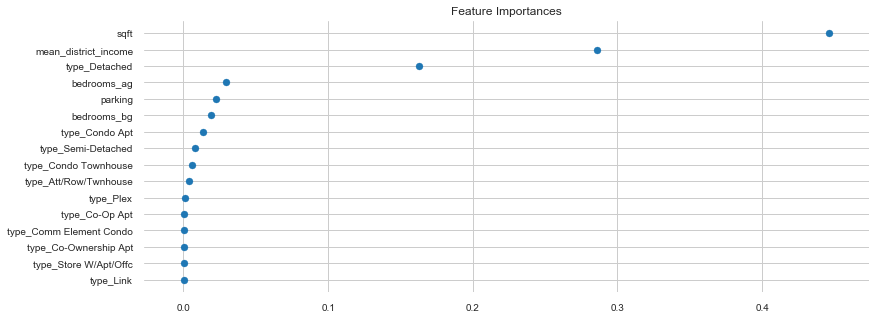

In [ ]:
from sklearn.ensemble import ExtraTreesRegressor

sns.set_style("whitegrid")
plt.figure(figsize=[13,5])
df = houses_dummies.dropna(subset=['sqft'])
model = ExtraTreesRegressor(n_estimators=10)
model.fit(df[predictors], df.final_price)
# display the relative importance of each attribute

sorted_feature_importance = sorted(zip(model.feature_importances_, df[predictors].columns))

x = [a[0] for a in sorted_feature_importance]
y = [a[1] for a in sorted_feature_importance]

plt.scatter(x,y)
plt.title('Feature Importances')
plt.show()

It appears that one of the most valuable feature is **sqft**. Since we’re missing some of this data I created a value count for present and missing sqft feature observations.

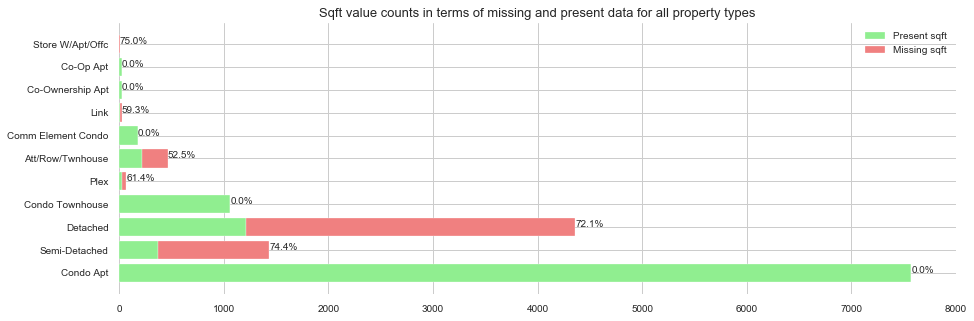

In [ ]:
house_type_notna, house_type_na = [], []

houses_types = pd.unique(houses_edited.type)

for house_type in houses_types:
    house_type_notna.append(sum((houses_edited.type == house_type) & (pd.notna(houses_edited.sqft))))
    house_type_na.append(sum((houses_edited.type == house_type) & (pd.isna(houses_edited.sqft))))

ind = np.arange(houses_types.shape[0])

plt.figure(figsize=[15,5])

width = 0.5
p1 = plt.barh(ind, house_type_notna, color='lightgreen')
p2 = plt.barh(ind, house_type_na, left=house_type_notna, color='lightcoral')

for no in ind:
    percent_missing = np.round((house_type_na[no] / (house_type_notna[no] + house_type_na[no]))*100, 1)
    plt.text(house_type_notna[no] + house_type_na[no], ind[no], str(percent_missing) + '%')


plt.xlim([0,8000])
plt.legend(['Present sqft', 'Missing sqft'])
plt.yticks(ind, houses_types)
plt.title('Sqft value counts in terms of missing and present data for all property types', fontsize=13)
plt.show()

Unfortunately a majority of detached houses lack square footage meaning imputing this data takes precedence.

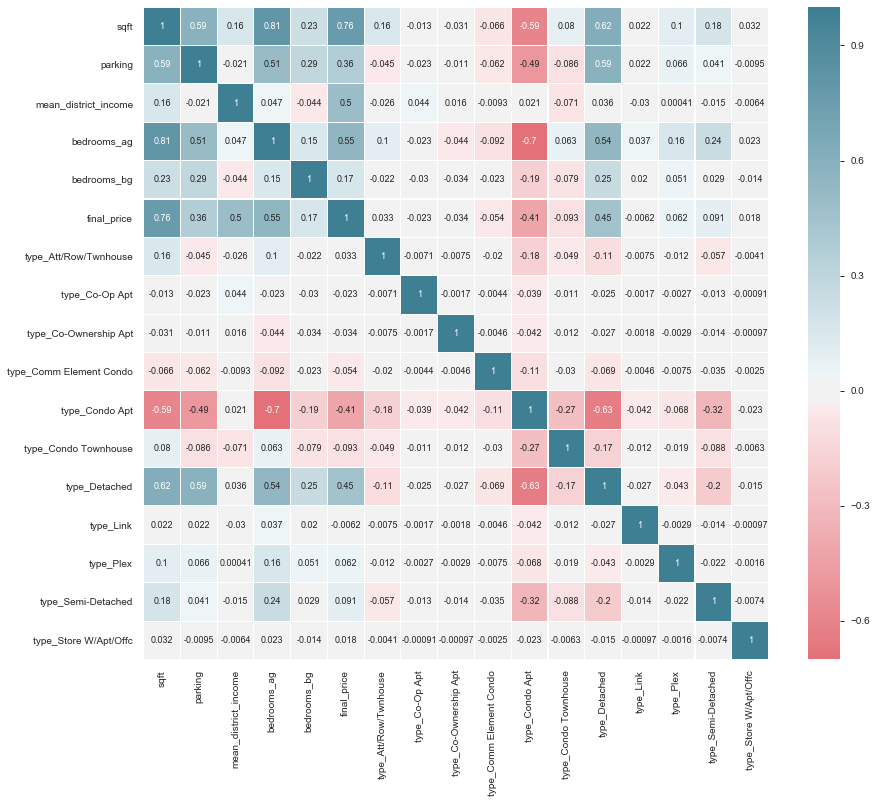

In [ ]:
# Create features Heatmap to see how feature are correlated with final_price

def correlantion_heatmap(df, center = None):
    fig, ax = plt.subplots(figsize = [14,12])
    colormap = sns.diverging_palette(10, 220, as_cmap=True)
    fig = sns.heatmap(df.corr(),
                cmap = colormap,
               center = center,
                annot = True,
                linewidths = 0.1,
                annot_kws={'fontsize':9})
    
    
correlantion_heatmap(houses_dummies, center=0)

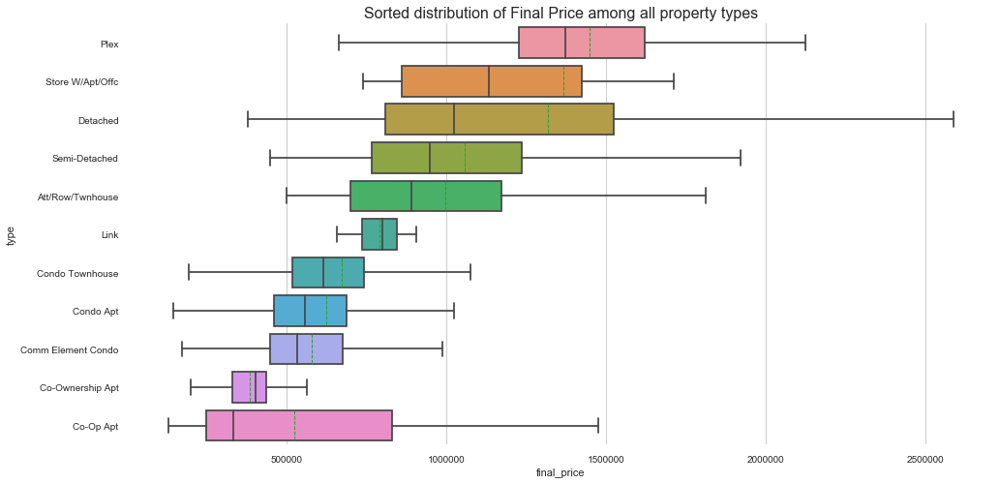

In [ ]:
sns.set_style("whitegrid")
plt.subplots(figsize=[16,8])
sorted_medians = sorted([(houses_edited[houses_edited.type==st].final_price.median(), st) for st in houses_types], reverse=True)
sns.boxplot(y = 'type', x = 'final_price', data = houses_edited, orient='h', showfliers=False, meanline =True, showmeans=True, 
            order=[b for a,b in sorted_medians])
plt.title('Sorted distribution of Final Price among all property types', fontsize=16)
plt.show()

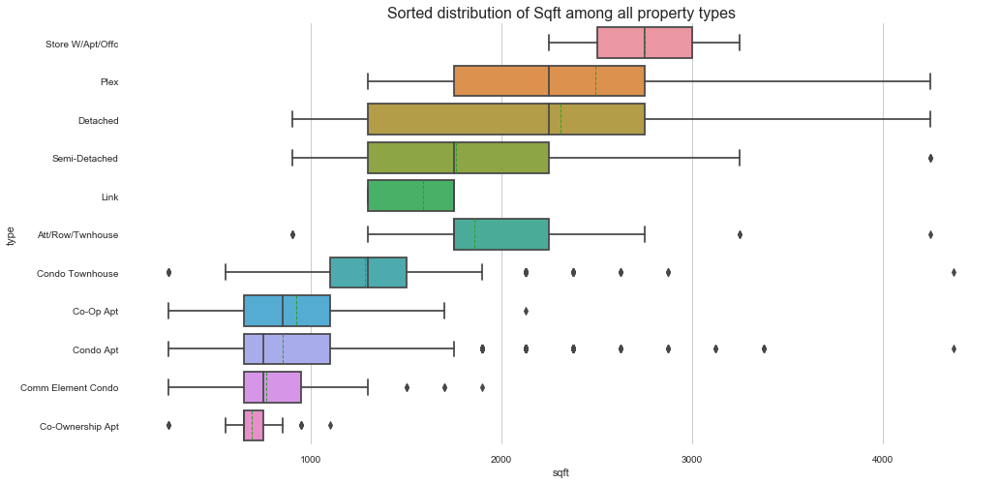

In [ ]:
plt.subplots(figsize=[16,8])
sorted_medians = sorted([(houses_edited[houses_edited.type==st].sqft.median(), st) for st in houses_types], reverse=True)
sns.boxplot(y = 'type', x = 'sqft', data = houses_edited, orient='h', showfliers=True, meanline =True, showmeans=True,
           order=[b for a,b in sorted_medians])
plt.title('Sorted distribution of Sqft among all property types', fontsize=16)
plt.show()

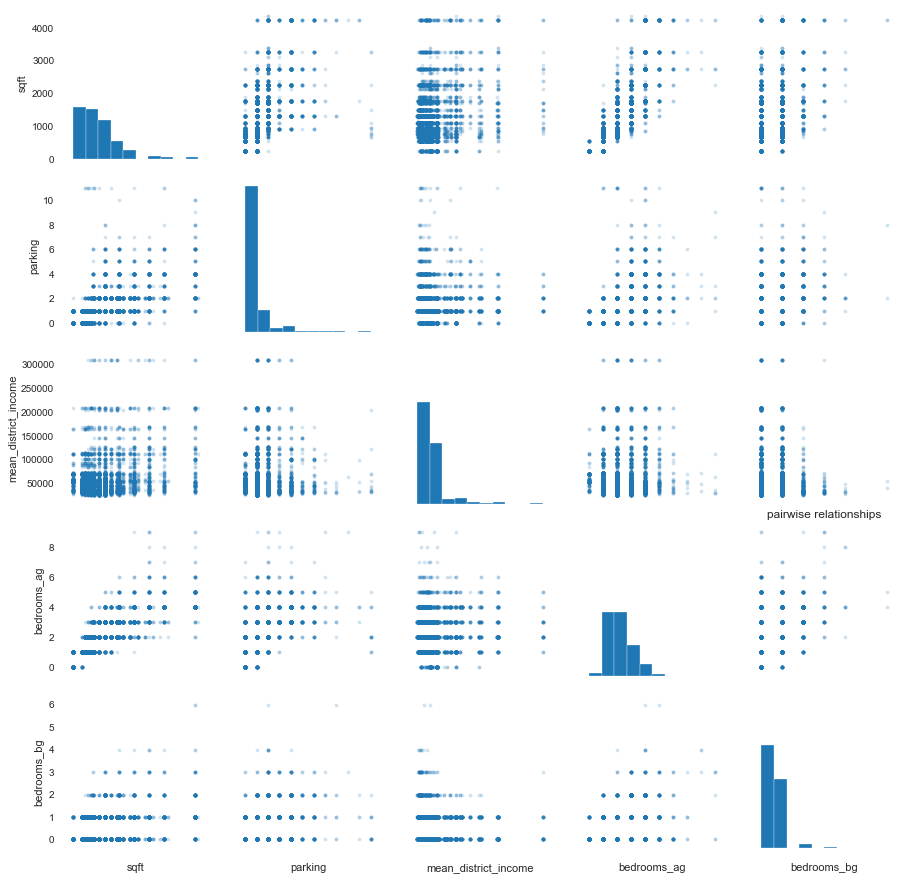

In [ ]:
# Plot pairwise relationships
sns.set_style("white")
pp = sns.pairplot(houses_dummies[pd.notna(houses_dummies.sqft)][predictors[:5]], diag_kind = 'hist', plot_kws=dict(s=14, alpha=.2, linewidth=0))
pp.set(xticklabels=[])
plt.show()

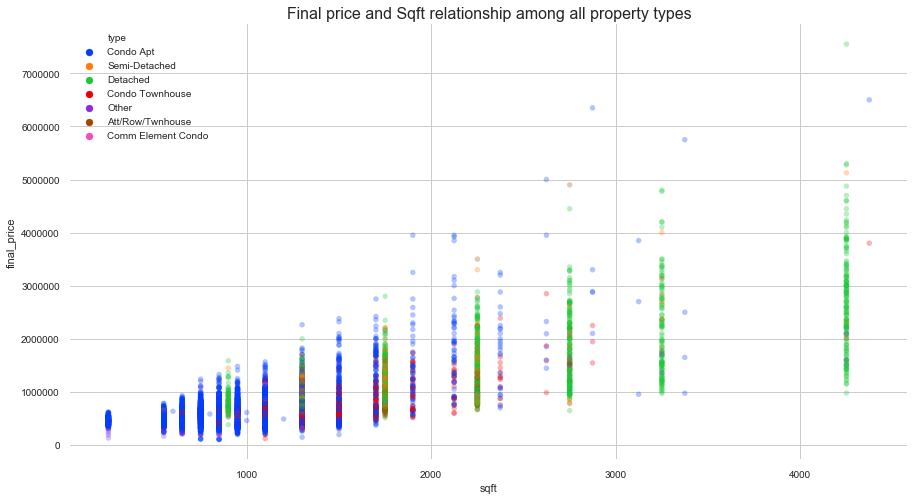

In [ ]:
# Check how final_price and sqft are related to each other among all property types
sns.set_style("whitegrid")
plt.figure(figsize=[15,8])
sns.scatterplot(x='sqft', y='final_price' ,data=houses_edited, 
                hue = houses_edited.type.replace({                   
                    'Plex': 'Other',
                    'Link': 'Other',
                    'Co-Ownership Apt': 'Other',
                    'Co-Op Apt': 'Other',
                    'Store W/Apt/Offc': 'Other'}),
                    linewidth=0, alpha=0.3, palette='bright', s=30)
plt.title('Final price and Sqft relationship among all property types', fontsize=16)
plt.show()

To replace missing values, we’ll create a custom imputer . To ensure it’s pipeline friendly we’ll inherit such base classes as **BaseEstimator** and **TransformerMixin**.

Imputations considered:
-	**Random Forest**. Impute missing values in predictor data using proximity from randomForest
-	**Knn**. Use non-parametric algorithm called k-nearest-neighbors (KNN) to replace missing values
-	**Mice**. Use Multivariate imputation by chained equations
-	**Mean**. Replace missing values by Mean of appropriate property time
-	**Median**. Replace missing values by Median of appropriate property time
-	**Mode**. Replace missing values by Mode of appropriate property time

After countless cross-validation value comparisons of different algorithms, I selected **MICE** due to it’s stability.

In [ ]:
from sklearn.base import BaseEstimator, TransformerMixin

class Impute_sqft(BaseEstimator, TransformerMixin):
    def __init__(self, how='random forest'):        
        self.how = how
        
    def fit(self, X, y=None):
        return self
        
    def transform(self, X):
        import sys
        sys.setrecursionlimit(100000) #Increase the recursion limit of the OS
        from impyute.imputation.cs import fast_knn, mice
        result = X.copy()
        
        if self.how == 'random forest':
            train_X = houses_dummies.dropna(subset=['sqft']).drop(columns=['sqft'])
            train_Y = houses_dummies.dropna(subset=['sqft'])['sqft']
            test_X = houses_dummies[pd.isna(houses_dummies.sqft)].drop(columns=['sqft'])

            rf = RandomForestRegressor()
            rf.fit(train_X, train_Y)
            pred_Y = rf.predict(test_X)
            result.loc[test_X.index,'sqft'] = pred_Y
        
        if self.how == 'knn':
            knn_n = 30
            result = fast_knn(houses_dummies, k=knn_n)
            result.columns = houses_dummies.columns
            result.index = houses_dummies.index
            result = result.loc[X.index,:]
    
        if self.how == 'mice':
            result = mice(houses_dummies)
            result.columns = houses_dummies.columns
            result.index = houses_dummies.index
            result = result.loc[X.index,:]
    
        if self.how == 'mean':
            result['sqft'] = houses_edited.groupby('type')['sqft'].transform(lambda x: x.fillna(x.mean(skipna=True)))
    
        if self.how == 'median':
            result['sqft'] = houses_edited.groupby('type')['sqft'].transform(lambda x: x.fillna(x.median(skipna=True)))
    
        if self.how == 'mode':
            result['sqft'] = houses_edited.groupby('type')['sqft'].transform(lambda x: x.fillna(x.mode()[0]))
        return result[predictors]

    
    
imputer = Impute_sqft(how='mice')
houses_nona = imputer.fit_transform(houses_dummies[predictors])

Previously we already transformed data through **Boxcox**, so this upcoming step is not necessary. One problem with **Boxcox** 

An unexpected issue I faced with **Boxcox** was conveniently reverting transformed values. It cannot convert negative values, which obviously conflicts when attempting to process a wide variety of models that produce positive as well as negative predictions. For this reason, the **Yeo-Johnson** transformation was considered instead.

> The Yeo-Johnson transformation can be thought of as an extension of the Box-Cox transformation. It handles both positive and negative values, whereas the Box-Cox transformation only handles positive values. Both can be used to transform the data so as to improve normality.

Again, let’s examine the feature skewness and correct the uppermost ones.

In [ ]:
numeric_feats = ['sqft', 'mean_district_income', 'final_price']
skewness = pd.DataFrame({
    'Skew': houses_dummies[numeric_feats].apply(lambda x: stats.skew(x.dropna())).sort_values(ascending=False)})

skewness = skewness[abs(skewness.Skew) > 0.75]
skewness

,Skew
final_price,4.224153
mean_district_income,3.352790
sqft,2.123690


In [ ]:
from sklearn.preprocessing import PowerTransformer
from sklearn.metrics import mean_squared_error, mean_absolute_error

houses_nona_copy = houses_nona.copy()
houses_nona_copy['mean_district_income'] = houses_nona.mean_district_income/10
houses_nona_copy['final_price'] = houses_dummies.final_price/100

# np.exp(np.log(boxcox_lambda*transformed_array+1)/boxcox_lambda)
yeo_johnson_lambdas = [] 
# for feature in skewness.index:
#     boxcox_lambda = stats.boxcox_normmax(houses_nona_copy[feature], brack=(-1.9, 2.0),  method='mle')
#     houses_nona_copy[feature] = boxcox1p(houses_nona_copy[feature], boxcox_lambda)
#     boxcox_lambdas.append(boxcox_lambda)

# for feature in skewness.index:
#     yeo_lambda = stats.yeojohnson_normmax(houses_nona_copy[feature].astype('float64'), brack=[-2.9,20])
#     houses_nona_copy[feature] = stats.yeojohnson(houses_nona_copy[feature].astype('float64'), lmbda=yeo_lambda)
#     boxcox_lambdas.append(yeo_lambda)

pt = PowerTransformer(method='yeo-johnson')
for numeric_feat in numeric_feats:
    houses_nona_copy[numeric_feat] = pt.fit_transform(houses_nona_copy[[numeric_feat]])
    yeo_johnson_lambdas.append(pt.lambdas_[0])
    
# rf = RandomForestRegressor()
# rf.fit(houses_nona_copy[predictors], houses_nona_copy['final_price'])
# prediction = rf.predict(houses_nona_copy[predictors])


# y = pt.inverse_transform(houses_nona_copy[['final_price']]) * 100
# y_pred = pt.inverse_transform(pd.DataFrame(prediction))  * 100
# mean_absolute_error(y, y_pred)

Split arrays or matrices into random train and test subsets

In [ ]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(houses_nona_copy[predictors], houses_nona_copy.final_price, train_size=0.7,
                                                    stratify=houses_nona_copy['type_Condo Apt'].values)

# Explore models and short-list the best ones

Check all available **Regressors**

In [ ]:
from sklearn.utils.testing import all_estimators
from sklearn import base

estimators = all_estimators()

for name, class_ in estimators:
    if issubclass(class_, base.RegressorMixin):
        print(name)

ARDRegression
AdaBoostRegressor
BaggingRegressor
BayesianRidge
CCA
DecisionTreeRegressor
DummyRegressor
ElasticNet
ElasticNetCV
ExtraTreeRegressor
ExtraTreesRegressor
GaussianProcessRegressor
GradientBoostingRegressor
HistGradientBoostingRegressor
HuberRegressor
IsotonicRegression
KNeighborsRegressor
KernelRidge
Lars
LarsCV
Lasso
LassoCV
LassoLars
LassoLarsCV
LassoLarsIC
LinearRegression
LinearSVR
MLPRegressor
MultiOutputRegressor
MultiTaskElasticNet
MultiTaskElasticNetCV
MultiTaskLasso
MultiTaskLassoCV
NuSVR
OrthogonalMatchingPursuit
OrthogonalMatchingPursuitCV
PLSCanonical
PLSRegression
PassiveAggressiveRegressor
RANSACRegressor
RadiusNeighborsRegressor
RandomForestRegressor
RegressorChain
Ridge
RidgeCV
SGDRegressor
SVR
TheilSenRegressor
TransformedTargetRegressor
VotingRegressor
_SigmoidCalibration


Create custom evaluation functions. First, transform both predicted and actual values to dollars and evaluate through one of these four metrics:

$$ \text{Mean squared error (MSE)}  = \frac{1}{n}\sum_{i=1}^{n}(y_i - x_i) ^2 $$

$$ \text{Root mean squared error (RMSE)}  = \sqrt{\frac{1}{n}\sum_{i=1}^{n}(y_i - x_i)  ^2} $$

$$ \text{Mean absolute error (MAE)} = \frac{1}{n}\sum_{i=1}^{n}|y_i - x_i  | $$

$$ \text{Mean absolute percentage error (MAPE)} = \frac{100\%}{n}\sum_{i=1}^{n} |\frac{y_i - x_i }{y_i}| $$

In [ ]:
def custom_mae_(y, y_pred, **kwargs):
    y_pred[y_pred > 5] = 5
    y = pt.inverse_transform(pd.DataFrame(y)) * 100
    y_pred = pt.inverse_transform(pd.DataFrame(y_pred))  * 100
    return mean_absolute_error(y, y_pred)

custom_mae = make_scorer(custom_mae_, greater_is_better=False)

def custom_mape_(y, y_pred, **kwargs):
    y_pred[y_pred > 5] = 5
    y = pt.inverse_transform(pd.DataFrame(y)) * 100
    y_pred = pt.inverse_transform(pd.DataFrame(y_pred))  * 100
    return np.mean(np.abs((y - y_pred) / y)) * 100

custom_mape = make_scorer(custom_mape_, greater_is_better=False)


def custom_rmse_(y, y_pred, **kwargs):
    y_pred[y_pred > 5] = 5
    y = pt.inverse_transform(pd.DataFrame(y)) * 100
    y_pred = pt.inverse_transform(pd.DataFrame(y_pred))  * 100
    return np.sqrt(mean_squared_error(y, y_pred))

custom_rmse = make_scorer(custom_rmse_, greater_is_better=False)

Now we can create estimator space and preselect 20 models that might contribute to our solution. Then we’ll run every algorithm through our train set, cross validate the results and save everything to one dataframe.

In [ ]:
from sklearn.ensemble import AdaBoostRegressor, BaggingRegressor, ExtraTreesRegressor, GradientBoostingRegressor, RandomForestRegressor
from sklearn.kernel_ridge import KernelRidge
from sklearn.linear_model import LinearRegression, LassoCV, RidgeCV, ElasticNetCV, ARDRegression, BayesianRidge, HuberRegressor, LarsCV, OrthogonalMatchingPursuitCV
from sklearn.neighbors import KNeighborsRegressor
from sklearn.svm import NuSVR, SVR
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import ShuffleSplit, cross_validate, GridSearchCV, KFold
from sklearn.isotonic import  IsotonicRegression
from sklearn.cross_decomposition import PLSRegression
from sklearn.preprocessing import RobustScaler
from sklearn.pipeline import make_pipeline
from sklearn.metrics import make_scorer
import lightgbm as lgb
import xgboost as xgb


#Machine Learning Algorithm (MLA) Selection and Initialization
MLA = [
#     #Ensemble Methods
    AdaBoostRegressor(),
    BaggingRegressor(),
    ExtraTreesRegressor(),
    GradientBoostingRegressor(),
    RandomForestRegressor(),
    lgb.LGBMRegressor(),
    xgb.XGBRegressor(objective='reg:squarederror'),
    
    
#     #Kernel ridge regression
#     KernelRidge(),
    
#     #GLM
    LinearRegression(),
    make_pipeline(RobustScaler(), LassoCV()),
    make_pipeline(RobustScaler(), ElasticNetCV()),
    RidgeCV(),
    LarsCV(),
    BayesianRidge(),
    HuberRegressor(),
    OrthogonalMatchingPursuitCV(),
    
#    #Decomposition
    PLSRegression(),
    
#     #KNN
    KNeighborsRegressor(),
    
    #SVM
    NuSVR(),
    SVR(),
    
#     #Tree Models
    DecisionTreeRegressor()   
    ]


#split dataset in cross-validation with this splitter class: http://scikit-learn.org/stable/modules/generated/sklearn.model_selection.ShuffleSplit.html#sklearn.model_selection.ShuffleSplit
#note: this is an alternative to train_test_split
cv_split = KFold(n_splits=4, shuffle=True, random_state=10) # run model 10x with 60/30 split intentionally leaving out 10%

#create table to compare MLA metrics
MLA_columns = ['MLA Name', 'MLA Parameters','MLA Train Accuracy Mean', 'MLA Test Accuracy Mean', 'MLA Test Accuracy 3*STD' ,'MLA Time']
MLA_compare = pd.DataFrame(columns = MLA_columns)

#index through MLA and save performance to table
row_index = 0
for alg in MLA:

    #set name and parameters
    MLA_name = alg.__class__.__name__
    print(MLA_name + '_'*10, end="\r")
    MLA_compare.loc[row_index, 'MLA Name'] = MLA_name
    MLA_compare.loc[row_index, 'MLA Parameters'] = str(alg.get_params())
    
    #score model with cross validation: http://scikit-learn.org/stable/modules/generated/sklearn.model_selection.cross_validate.html#sklearn.model_selection.cross_validate
    cv_results = cross_validate(alg, X_train, y_train, cv  = cv_split,
                               return_train_score=True, scoring=custom_mae)

    MLA_compare.loc[row_index, 'MLA Time'] = cv_results['fit_time'].mean()
    MLA_compare.loc[row_index, 'MLA Train Accuracy Mean'] = -cv_results['train_score'].mean()
    MLA_compare.loc[row_index, 'MLA Test Accuracy Mean'] = -cv_results['test_score'].mean()
    #if this is a non-bias random sample, then +/-3 standard deviations (std) from the mean, should statistically capture 99.7% of the subsets
    MLA_compare.loc[row_index, 'MLA Test Accuracy 3*STD'] = cv_results['test_score'].std()*3   #let's know the worst that can happen!
    
    row_index+=1
    
    
MLA_compare.sort_values('MLA Test Accuracy Mean', inplace = True, ascending = True)
MLA_compare

,MLA Name,MLA Parameters,MLA Train Accuracy Mean,MLA Test Accuracy Mean,MLA Test Accuracy 3*STD,MLA Time
2,ExtraTreesRegressor,"{'bootstrap': False, 'criterion': 'mse', 'max_...",19134.6,106956,11702.9,0.137621
5,LGBMRegressor,"{'boosting_type': 'gbdt', 'class_weight': None...",95650.3,107365,10767.6,0.123217
4,RandomForestRegressor,"{'bootstrap': True, 'criterion': 'mse', 'max_d...",52439,108170,10806.6,0.133788
1,BaggingRegressor,"{'base_estimator': None, 'bootstrap': True, 'b...",52403.8,108189,11258.9,0.154671
19,DecisionTreeRegressor,"{'criterion': 'mse', 'max_depth': None, 'max_f...",19134.6,125722,19948.9,0.0231898
3,GradientBoostingRegressor,"{'alpha': 0.9, 'criterion': 'friedman_mse', 'i...",124136,129216,10306.2,0.427266
6,XGBRegressor,"{'base_score': 0.5, 'booster': 'gbtree', 'cols...",124697,129707,10988.3,0.753336
18,SVR,"{'C': 1.0, 'cache_size': 200, 'coef0': 0.0, 'd...",130863,134976,15787.3,2.25922
17,NuSVR,"{'C': 1.0, 'cache_size': 200, 'coef0': 0.0, 'd...",133099,136451,15115.9,2.46961
16,KNeighborsRegressor,"{'algorithm': 'auto', 'leaf_size': 30, 'metric...",114038,139127,12815.7,0.0283276


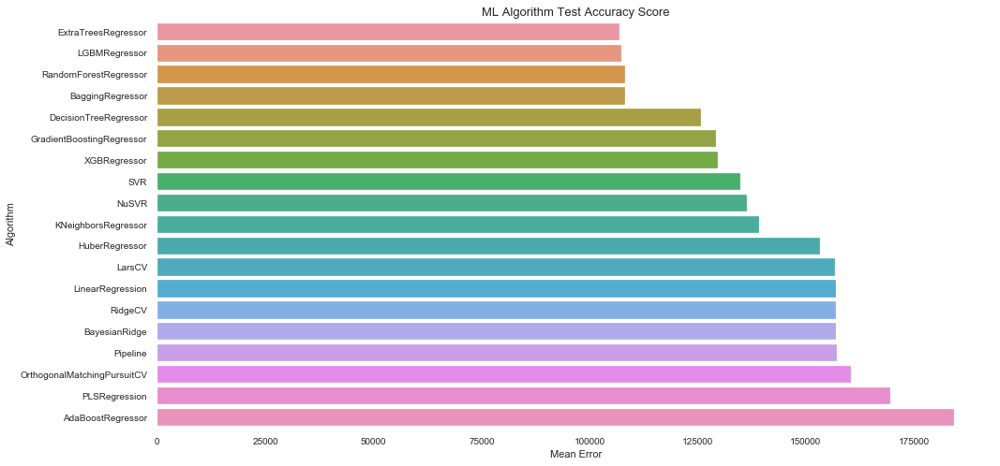

In [ ]:
fig, ax = plt.subplots(figsize = [16,8])

sns.barplot(x = 'MLA Test Accuracy Mean', y = 'MLA Name', data = MLA_compare,)
plt.title('ML Algorithm Test Accuracy Score', fontsize=13)
plt.xlabel('Mean Error')
plt.ylabel('Algorithm')
plt.show()

A short-list of the top estimators (also my favorites):
- LightGBM
- XGBoost
- RandomForest

# Hyperparameter tuning

Structure of this paragraph:
1. LightGBM with Hyperopt
2. LightGBM with RandomSearchCV
3. Hyperopt vs RandomSearchCV
4. XGboost with Hyperopt
5. RandomForest with Hyperopt

### LightGBM with Hyperopt

There are many approaches to hyperparameters’ tuning. Some examples include manual trial and error, performing **Grid Search/Random Grid** Search and more sophisticated, automated approaches like **Bayesian Optimization** (which are provided by the **Hyperopt** package).


> Hyperopt is a constrained global optimization package built upon bayesian inference and gaussian process, that attempts to find the maximum value of an unknown function in as few iterations as possible. This technique is particularly suited for optimization of high cost functions, situations where the balance between exploration and exploitation is important.


There are four parts to a Bayesian Optimization problem:
1. **Objective Function:** what we want to minimize, in this case the validation error of a machine learning model with respect to the hyperparameters
2. **Domain Space:** hyperparameter values to search over
3. **Optimization algorithm:** method for constructing the surrogate model and choosing the next hyperparameter values to evaluate
4. **Result history:** stored outcomes from evaluations of the objective function consisting of the hyperparameters and validation loss

Let's start with defining evaluation metric and creating an objective

In [ ]:
import csv
from hyperopt import STATUS_OK
from timeit import default_timer as timer

MAX_EVALS = 200

train_set = lgb.Dataset(X_train, label = y_train)

# f(preds: array, train_data: Dataset) -> name: string, eval_result: float, is_higher_better: bool
# How: https://github.com/Microsoft/LightGBM/blob/master/examples/python-guide/advanced_example.py
def custom_mae_lgb(y_pred, y):
    # Replace too big values
    y_pred[y_pred > 5] = 5
    
    y = pt.inverse_transform(pd.DataFrame(y.get_label())) * 100
    y_pred = pt.inverse_transform(pd.DataFrame(y_pred))  * 100
    return 'custom_mae_lgb', mean_absolute_error(y, y_pred), False


def objective(params):
    """Objective function for Gradient Boosting Machine Hyperparameter Optimization"""
    
    # Keep track of evals
    global ITERATION
    
    ITERATION += 1
    
    # Retrieve the subsample if present otherwise set to 1.0
    subsample = params['boosting_type'].get('subsample', 1.0)
    
    # Extract the boosting type
    params['boosting_type'] = params['boosting_type']['boosting_type']
    params['subsample'] = subsample
    
    # Make sure parameters that need to be integers are integers
    for parameter_name in ['num_leaves', 'subsample_for_bin', 'min_child_samples']:
        params[parameter_name] = int(params[parameter_name])
        
    start = timer()

    # Perform n_folds cross validation
    cv_results = lgb.cv(params, train_set, num_boost_round = 1000, folds=cv_split, 
                        early_stopping_rounds = 50, seed = 50, stratified=False, feval=custom_mae_lgb)
    
    run_time = timer() - start
    
    # Extract the best score, Loss must be minimized
    best_score = np.min(cv_results['custom_mae_lgb-mean'])
    
    loss = best_score
    
    # Boosting rounds that returned the highest cv score
    n_estimators = int(np.argmin(cv_results['custom_mae_lgb-mean']) + 1)
    
    
    # Dictionary with information for evaluation
    return {'loss': best_score, 'params': params, 'iteration': ITERATION,
            'estimators': n_estimators, 
            'train_time': run_time, 'status': STATUS_OK}

Define the search space

In [ ]:
from hyperopt import hp
from hyperopt.pyll.stochastic import sample

space = {
    'class_weight': hp.choice('class_weight', [None, 'balanced']),
    'boosting_type': hp.choice('boosting_type', [{'boosting_type': 'gbdt', 'subsample': hp.uniform('gdbt_subsample', 0.5, 1)}, 
                                                 {'boosting_type': 'dart', 'subsample': hp.uniform('dart_subsample', 0.5, 1)},
                                                 {'boosting_type': 'goss', 'subsample': 1.0}]),
    'num_leaves': hp.quniform('num_leaves', 30, 150, 1),
    'learning_rate': hp.loguniform('learning_rate', np.log(0.01), np.log(0.2)),
    'subsample_for_bin': hp.quniform('subsample_for_bin', 20000, 300000, 20000),
    'min_child_samples': hp.quniform('min_child_samples', 20, 500, 5),
    'reg_alpha': hp.uniform('reg_alpha', 0.0, 1.0),
    'reg_lambda': hp.uniform('reg_lambda', 0.0, 1.0),
    'colsample_bytree': hp.uniform('colsample_by_tree', 0.6, 1.0)
}

In [ ]:
from hyperopt import tpe
from hyperopt import Trials

# optimization algorithm
tpe_algorithm = tpe.suggest

# Keep track of results
bayes_trials = Trials()

# Global variable
global  ITERATION

ITERATION = 0

In [ ]:
from hyperopt import fmin

%sc

# Run optimization
lgb_best = fmin(fn = objective, space = space, algo = tpe.suggest, 
            max_evals = MAX_EVALS, trials = bayes_trials, rstate = np.random.RandomState(10))

# Sort the trials with lowest loss (highest AUC) first
lgb_trials_results = sorted(bayes_trials.results, key = lambda x: x['loss'])

100%|████████████████████████████████████████████████| 200/200 [1:20:25<00:00, 19.30s/it, best loss: 95339.77256544177]


In [ ]:
# Convert to a dataframe
lgb_results = pd.DataFrame(lgb_trials_results)
lgb_results.head()

,loss,params,iteration,estimators,train_time,status
0,95339.772565,"{'boosting_type': 'gbdt', 'class_weight': 'bal...",164,976,14.257240,ok
1,95400.560135,"{'boosting_type': 'gbdt', 'class_weight': 'bal...",48,668,9.262662,ok
2,95439.916545,"{'boosting_type': 'gbdt', 'class_weight': None...",157,667,10.826381,ok
3,95510.341427,"{'boosting_type': 'gbdt', 'class_weight': None...",114,820,12.350901,ok
4,95631.571706,"{'boosting_type': 'gbdt', 'class_weight': None...",127,516,10.407329,ok


In [ ]:
# Save best parameters
best_lgb_estimators= lgb_results.loc[0,'estimators']
best_lgb_params= lgb_results.loc[0,'params']

#Fit the best parameters to the model
best_lgb_model = lgb.LGBMRegressor(n_estimators=best_lgb_estimators, n_jobs = -1, 
                                     random_state = 50, **best_lgb_params)

In [ ]:
#Save parameters. *Just in case*
# best_lgb_model = lgb.LGBMRegressor(boosting_type='gbdt', class_weight='balanced',
#               colsample_bytree=0.9414862936943954, importance_type='split',
#               learning_rate=0.07074010161873992, max_depth=-1,
#               min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
#               n_estimators=976, n_jobs=-1, num_leaves=38, objective=None,
#               random_state=50, reg_alpha=0.6547434726382414,
#               reg_lambda=0.7404502093528875, silent=True,
#               subsample=0.5213499245813108, subsample_for_bin=180000,
#               subsample_freq=0)

### LightGBM with RandomSearch

In [ ]:
# Hyperparameter grid
param_grid = {
    'class_weight': [None, 'balanced'],
    'boosting_type': ['gbdt', 'goss', 'dart'],
    'num_leaves': list(range(30, 150)),
    'learning_rate': list(np.logspace(np.log(0.005), np.log(0.2), base = np.exp(1), num = 1000)),
    'subsample_for_bin': list(range(20000, 300000, 20000)),
    'min_child_samples': list(range(20, 500, 5)),
    'reg_alpha': list(np.linspace(0, 1)),
    'reg_lambda': list(np.linspace(0, 1)),
    'colsample_bytree': list(np.linspace(0.6, 1, 10))
}

# Subsampling (only applicable with 'goss')
subsample_dist = list(np.linspace(0.5, 1, 100))

params = {key: np.random.choice(value) for key, value in param_grid.items()}
params

{'class_weight': None,
 'boosting_type': 'goss',
 'num_leaves': 128,
 'learning_rate': 0.10636616732547971,
 'subsample_for_bin': 120000,
 'min_child_samples': 165,
 'reg_alpha': 0.7755102040816326,
 'reg_lambda': 0.7959183673469387,
 'colsample_bytree': 0.7333333333333333}

In [ ]:
def random_objective(params, iteration, n_folds = N_FOLDS):
    """Random search objective function. Takes in hyperparameters
       and returns a list of results to be saved."""

    start = timer()
    
    # Perform n_folds cross validation
    cv_results = lgb.cv(params, train_set, num_boost_round=1000, folds=cv_split, 
                        early_stopping_rounds=50, seed=50, stratified=False, feval=custom_mae_lgb)
    end = timer()
    best_score = np.min(cv_results['custom_mae_lgb-mean'])
    
    # Loss must be minimized
    loss = best_score
    
    # Boosting rounds that returned the highest cv score
    n_estimators = int(np.argmin(cv_results['custom_mae_lgb-mean']) + 1)
    
    # Return list of results
    return [loss, params, iteration, n_estimators, end - start]

In [ ]:
np.random.seed(50)

# Dataframe to hold cv results
random_results = pd.DataFrame(columns = ['loss', 'params', 'iteration', 'estimators', 'time'],
                       index = list(range(MAX_EVALS)))

# Iterate through the specified number of evaluations
for i in range(MAX_EVALS):
    print(i, end='\r')
    # Randomly sample parameters for gbm
    params = {key: np.random.choice(value) for key, value in param_grid.items()}
    
    if params['boosting_type'] == 'goss':
        # Cannot subsample with goss
        params['subsample'] = 1.0
    else:
        # Subsample supported for gdbt and dart
        params['subsample'] = np.random.choice(subsample_dist)
        
        
    results_list = random_objective(params, i)
    
    # Add results to next row in dataframe
    random_results.loc[i, :] = results_list

In [ ]:
# Sort results by best validation score
random_results.sort_values('loss', ascending = True, inplace = True)
random_results.reset_index(inplace = True, drop = True)
random_results.head()

,loss,params,iteration,estimators,time
0,97548.9,"{'class_weight': 'balanced', 'boosting_type': ...",22,1,82.3139
1,98059.9,"{'class_weight': None, 'boosting_type': 'dart'...",4,1,111.378
2,100065,"{'class_weight': 'balanced', 'boosting_type': ...",83,1,94.8931
3,100378,"{'class_weight': 'balanced', 'boosting_type': ...",56,1,112.808
4,101200,"{'class_weight': None, 'boosting_type': 'dart'...",15,1,105.507


### Hyperopt vs RandomSearchCV

As you can see the Bayesian optimization takes less time to complete, more efficiently searches parameters thereby achieving a lower loss after every iteration.

In [ ]:
best_random_params = random_results.loc[0,'params']
best_random_estimators = random_results.loc[0,'estimators']

print('The best model through Bayesian search scores: ', int(lgb_results.loc[0,'loss']), 'found in ',
      int(lgb_results.loc[0,'iteration']), ' Total time: ', int(lgb_results.train_time.sum()))

print('The best model through Random search scores: ', int(random_results.loc[0,'loss']), 'found in ',
      int(random_results.loc[0,'iteration']), ' Total time: ', int(random_results.time.sum()))

The best model through Bayesian search scores:  95339 found in  164  Total time:  4816
The best model through Random search scores:  97548 found in  22  Total time:  6445


By comparing our results with those of the random search, both in numbers and figures, we can begin to understand how Bayesian Optimization functions. First, we can look at the best hyperparameters (as determined from the validation error) from both searches.

In [ ]:
# Merge borth parameter tables to one

# lgb_results = lgb_results.rename({'train_time':'time'}, axis=1).drop(columns=['status'], axis=1)
lgb_results['method'] = 'Bayesian search'
random_results['method'] = 'Random Search'
all_lgb_results = pd.concat([lgb_results, random_results])

all_lgb_results = pd.concat([all_lgb_results, 
                             pd.DataFrame(columns=list(all_lgb_results.loc[0,'params'].to_dict()[0].keys()),index=all_lgb_results.index)],
                            axis=1)

all_lgb_results.reset_index(inplace=True)

# Create a new colmn for each parameter and copy-paste it from params column

for i, params in enumerate(all_lgb_results['params']):
    for param in params.keys():
        all_lgb_results.loc[i,param] = params[param]

all_lgb_results.head()

,index,loss,params,iteration,estimators,time,method,class_weight,boosting_type,num_leaves,learning_rate,subsample_for_bin,min_child_samples,reg_alpha,reg_lambda,colsample_bytree,subsample
0,0,95339.8,"{'boosting_type': 'gbdt', 'class_weight': 'bal...",164,976,14.2572,Bayesian search,balanced,gbdt,38,0.0707401,180000,20,0.654743,0.74045,0.941486,0.52135
1,1,95400.6,"{'boosting_type': 'gbdt', 'class_weight': 'bal...",48,668,9.26266,Bayesian search,balanced,gbdt,43,0.105653,200000,20,0.449433,0.657898,0.853104,0.503618
2,2,95439.9,"{'boosting_type': 'gbdt', 'class_weight': None...",157,667,10.8264,Bayesian search,None,gbdt,65,0.0886145,180000,20,0.577931,0.658745,0.876343,0.614874
3,3,95510.3,"{'boosting_type': 'gbdt', 'class_weight': None...",114,820,12.3509,Bayesian search,None,gbdt,63,0.0719526,240000,20,0.679411,0.754602,0.927349,0.502289
4,4,95631.6,"{'boosting_type': 'gbdt', 'class_weight': None...",127,516,10.4073,Bayesian search,None,gbdt,67,0.102529,220000,20,0.383427,0.616626,0.875316,0.602123


It does appear that the validation loss for the Bayesian optimization is lower than that for Random Search. However this does not necessarily translate to a better testing score!

Bayesian optimization should get better over time. Let's plot the scores against the iteration to determine if there was any improvement.

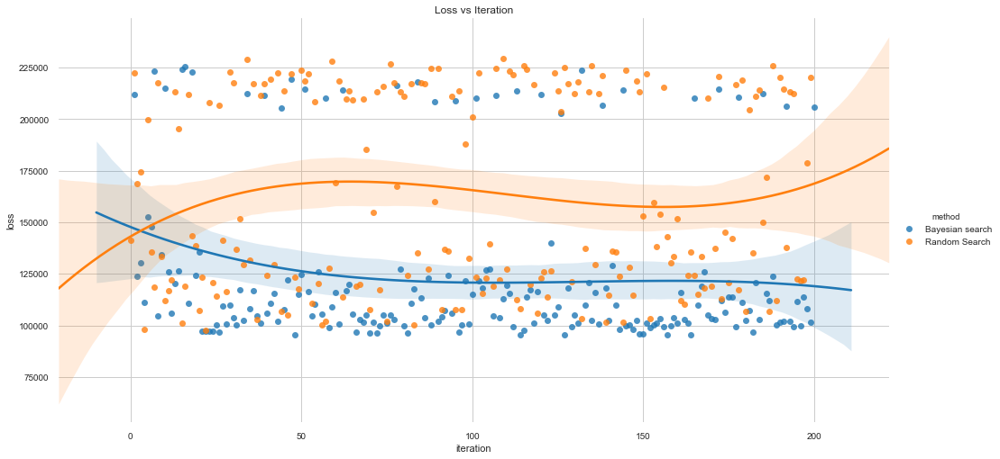

In [ ]:
for param in ['iteration', 'estimators', 'num_leaves', 'subsample_for_bin', 'min_child_samples', 'loss']:
    all_lgb_results[param] = all_lgb_results[param].astype('float')
lmplot_1 = sns.lmplot('iteration', 'loss', hue='method', data=all_lgb_results, aspect=2, height=7, order=3)
plt.title('Loss vs Iteration')
plt.show()

Random search uses the boosting types with the same frequency. However, Bayesian Optimization might have determined that one boosting type is superior than another for a particular problem.

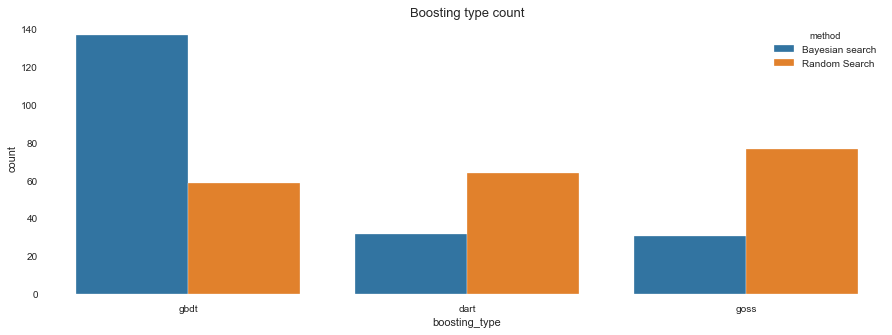

In [ ]:
plt.figure(figsize=[15,5])
sns.countplot('boosting_type', hue='method', data=all_lgb_results)
plt.title('Boosting type count', fontsize=13)
plt.show()

Sure enough, the Bayesian Optimization opted for the gradient-boosted decision tree boosting type more often than any other type. We could use this information to inform subsequent searches for the optimal hyperparameters by focusing on smaller domains.

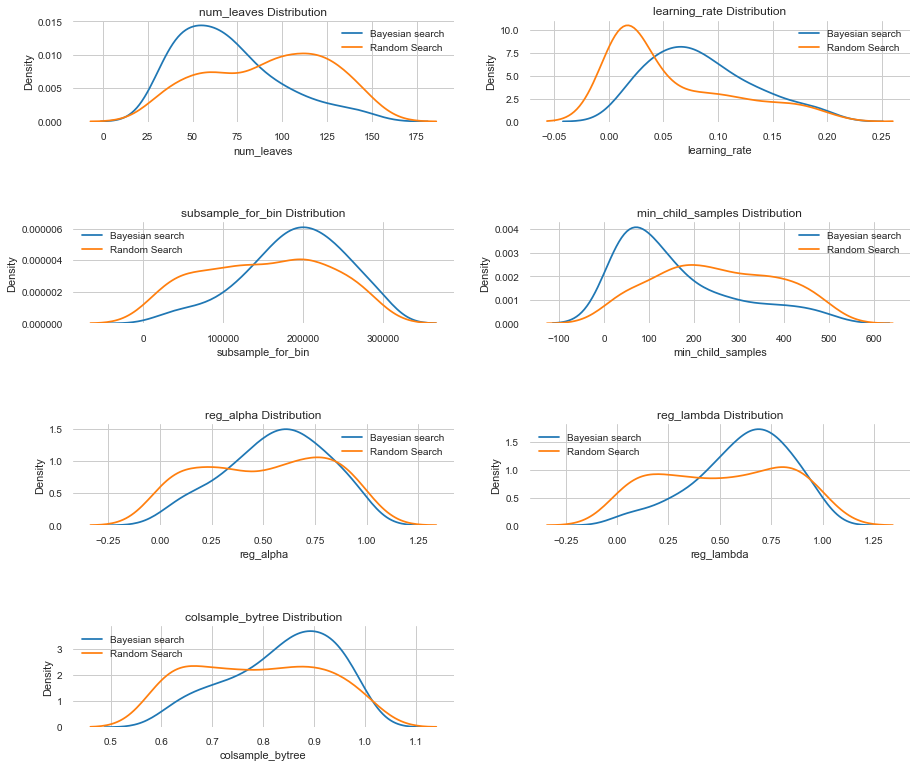

In [ ]:
num_params = ['num_leaves', 'learning_rate', 'subsample_for_bin', 'min_child_samples', 
              'reg_alpha', 'reg_lambda', 'colsample_bytree']

plt.figure(figsize=[15,13])
plt.subplots_adjust(hspace=1)
for i, param in enumerate(num_params):
    plt.subplot(4,2,i+1)
    for method in ['Bayesian search', 'Random Search']:    
        sns.kdeplot(all_lgb_results[all_lgb_results.method==method][param], label=method)
    plt.title(param + ' Distribution')
    plt.xlabel(param), plt.ylabel('Density')        

### XGBoost with Hyperopt

In [ ]:
from hyperopt.pyll.stochastic import sample

MAX_EVALS = 102

train_set = xgb.DMatrix(X_train.values, label = y_train.values)

def custom_mae_xgb(y_pred, y):
    # Replace too big values
    y_pred[y_pred > 5] = 5
    
    y = pt.inverse_transform(pd.DataFrame(y.get_label())) * 100
    y_pred = pt.inverse_transform(pd.DataFrame(y_pred))  * 100
    return 'custom_mae_xgb', mean_absolute_error(y, y_pred)


def objective(params):
    """Objective function for Gradient Boosting Machine Hyperparameter Optimization"""
    
    # Keep track of evals
    global ITERATION
    
    ITERATION += 1
    
#     # Retrieve the subsample if present otherwise set to 1.0
#     subsample = params['boosting_type'].get('subsample', 1.0)
    
#     # Extract the boosting type
#     params['boosting_type'] = params['boosting_type']['boosting_type']
#     params['subsample'] = subsample
    
    # Make sure parameters that need to be integers are integers
    for parameter_name in ['max_depth', 'min_child_weight']:
        params[parameter_name] = int(params[parameter_name])
        
    start = timer()

    # Perform n_folds cross validation
    cv_results = xgb.cv(params, train_set, num_boost_round = 500, folds = cv_split, 
                        early_stopping_rounds = 50, seed = 50, feval=custom_mae_xgb)
    
    run_time = timer() - start
    
    # Extract the best score, Loss must be minimized
    best_score = np.min(cv_results['test-custom_mae_xgb-mean'])
    
    loss = best_score
    
    # Boosting rounds that returned the highest cv score
    n_estimators = int(np.argmin(cv_results['test-custom_mae_xgb-mean']) + 1)
    
    
    # Dictionary with information for evaluation
    return {'loss': best_score, 'params': params, 'iteration': ITERATION,
            'estimators': n_estimators, 
            'train_time': run_time, 'status': STATUS_OK}



# Define the search space
space = {
    'booster': hp.choice('booster', ['gbtree', 'gblinear', 'dart']),
    'max_depth': hp.quniform('max_depth', 1, 10, 1),
    'learning_rate': hp.loguniform('learning_rate', np.log(0.01), np.log(0.2)),
    'gamma': hp.quniform('gamma', 0.5,5,0.5),
    'min_child_weight': hp.quniform('min_child_weight', 1, 20, 1),
    'subsample': hp.uniform('subsample', 0.5, 1),
    'colsample_bytree': hp.uniform('colsample_by_tree', 0.6, 1.0),
    'reg_alpha': hp.uniform('reg_alpha', 0.0, 1.0),
    'reg_lambda': hp.uniform('reg_lambda', 0.0, 1.0)
}

# optimization algorithm
tpe_algorithm = tpe.suggest

# Keep track of results
bayes_trials = Trials()

# Global variable
global  ITERATION

ITERATION = 0

In [ ]:
from hyperopt import fmin

lgb_best = fmin(fn = objective, space = space, algo = tpe.suggest, 
            max_evals = MAX_EVALS, trials = bayes_trials, rstate = np.random.RandomState(10))

In [ ]:
xgb_trials_results = sorted(bayes_trials.results, key = lambda x: x['loss'])

xgb_results = pd.DataFrame(xgb_trials_results)
best_xgb_estimators= xgb_results.loc[0,'estimators']
best_xgb_params= xgb_results.loc[0,'params']

best_xgb_model = xgb.XGBRegressor(n_estimators=best_xgb_estimators, n_jobs = -1, 
                                     random_state = 50, **best_xgb_params)

In [ ]:
# best_xgb_model = xgb.XGBRegressor(base_score=0.5, booster='dart', colsample_bylevel=1,
#                              colsample_bynode=1, colsample_bytree=0.9852485913905719, gamma=0.5,
#                              importance_type='gain', learning_rate=0.17273986878628944,
#                              max_delta_step=0, max_depth=10, min_child_weight=5, missing=None,
#                              n_estimators=499, n_jobs=-1, nthread=None, objective='reg:squarederror',
#                              random_state=50, reg_alpha=0.11100092585505658,
#                              reg_lambda=0.043501571995855526, scale_pos_weight=1, seed=None,
#                              silent=None, subsample=0.9709007140859235, verbosity=1)

### RandomForest with Hyperopt

In [ ]:
MAX_EVALS = 200

def objective(params):
    """Objective function for Gradient Boosting Machine Hyperparameter Optimization"""
    
# Keep track of evals
    global ITERATION
    
    ITERATION += 1
    
    params['oob_score'] = params['bootstrap']['oob_score']
    params['bootstrap'] = params['bootstrap']['bootstrap']
    
    for parameter_name in ['min_samples_leaf', 'min_samples_split', 'n_estimators']:
            params[parameter_name] = int(params[parameter_name])
        
    start = timer()

    rf = RandomForestRegressor(**params)
    cv_results = cross_validate(rf, X_train, y_train, cv  = cv_split, scoring=custom_mae)
    
    run_time = timer() - start
    
    best_score = -cv_results['test_score'].mean()
    
    loss = best_score
    return {'loss': best_score, 'params': params, 'iteration': ITERATION,
            'train_time': run_time, 'status': STATUS_OK}
    
space = {
    'bootstrap': hp.choice('bootstrap', [{'bootstrap': True, 'oob_score': True}, 
                                         {'bootstrap': True, 'oob_score': False}]),
    'max_features': hp.choice('max_features', ['auto', 'sqrt']),
    'max_depth': hp.choice('max_depth', [None,1,2,3]),
    'min_samples_split': hp.quniform('min_samples_split', 2,20,1),
    'min_samples_leaf': hp.quniform('min_samples_leaf ', 1,10,1),
    'n_estimators': hp.quniform('n_estimators  ',20,1000,10)
}

In [ ]:
tpe_algorithm = tpe.suggest
bayes_trials = Trials()
ITERATION = 0

In [ ]:
rf_best = fmin(fn = objective, space = space, algo = tpe.suggest, 
            max_evals = MAX_EVALS, trials = bayes_trials, rstate = np.random.RandomState(10))

100%|███████████████████████████████████████████████████| 90/90 [31:07<00:00, 19.35s/it, best loss: 103431.57960144762]


In [ ]:
rf_trials_results = sorted(bayes_trials.results, key = lambda x: x['loss'])

rf_results = pd.DataFrame(rf_trials_results)
best_rf_params= rf_results.loc[0,'params']

best_rf_model = RandomForestRegressor(random_state = 50, **best_rf_params)

In [ ]:
# best_rf_model = RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
#                       max_features='auto', max_leaf_nodes=None,
#                       min_impurity_decrease=0.0, min_impurity_split=None,
#                       min_samples_leaf=1, min_samples_split=3,
#                       min_weight_fraction_leaf=0.0, n_estimators=660,
#                       n_jobs=None, oob_score=False, random_state=50, verbose=0,
#                       warm_start=False)

# Averaging and Stacking models

### Averaged base models class

We begin with this simple approach for averaging base models. We create a new class that extends scikit-learn with our model which also lets us reuse code and leverage encapsulation.

In [ ]:
from sklearn.base import RegressorMixin, TransformerMixin, BaseEstimator, clone

class AveragingModels(BaseEstimator, RegressorMixin, TransformerMixin):
    def __init__(self, models):
        self.models = models
        
    # we define clones of the original models to fit the data in
    def fit(self, X, y):
        self.models_ = [clone(x) for x in self.models]
        
        # Train cloned base models
        for model in self.models_:
            model.fit(X, y)

        return self
    
    #Now we do the predictions for cloned models and average them
    def predict(self, X):
        predictions = np.column_stack([
            model.predict(X) for model in self.models_
        ])
        return np.mean(predictions, axis=1)
    
    
averaged_models = AveragingModels(models=(best_lgb_model, best_xgb_model, best_rf_model))
averaged_results = cross_validate(averaged_models, X_train, y_train, cv  = cv_split, scoring=custom_mae)

print('Cross-Validated score on train data: ', -averaged_results['test_score'].mean())

Cross-Validated score on train data: 97875.9151127886


### StackingCVRegressor

<img src="img/stacking_cv_regressor_overview.png" alt="Drawing"  />

In [ ]:
# Read for details: http://rasbt.github.io/mlxtend/user_guide/regressor/StackingCVRegressor/#targetText=Stacking%20is%20an%20ensemble%20learning,for%20the%20level%2D2%20regressor.

class StackingAveragedModels(BaseEstimator, RegressorMixin, TransformerMixin):
    def __init__(self, base_models, meta_model, cv=cv_split):
        self.base_models = base_models
        self.meta_model = meta_model
        self.cv = cv
   
    # We again fit the data on clones of the original models
    def fit(self, X, y):
        self.base_models_ = [list() for x in self.base_models]
        self.meta_model_ = clone(self.meta_model)
        
        # Train cloned base models then create out-of-fold predictions
        # that are needed to train the cloned meta-model
        out_of_fold_predictions = np.zeros((X.shape[0], len(self.base_models)))
        for i, model in enumerate(self.base_models):
            for train_index, holdout_index in cv_split.split(X, y):
                instance = clone(model)
                self.base_models_[i].append(instance)
                instance.fit(X.iloc[train_index], y.iloc[train_index])
                y_pred = instance.predict(X.iloc[holdout_index])
                out_of_fold_predictions[holdout_index, i] = y_pred
                
        # Now train the cloned  meta-model using the out-of-fold predictions as new feature
        self.meta_model_.fit(out_of_fold_predictions, y)
        return self
   
    #Do the predictions of all base models on the test data and use the averaged predictions as 
    #meta-features for the final prediction which is done by the meta-model
    def predict(self, X):
        meta_features = np.column_stack([
            np.column_stack([model.predict(X) for model in base_models]).mean(axis=1)
            for base_models in self.base_models_ ])
        return self.meta_model_.predict(meta_features)
    
stacked_models = StackingAveragedModels(base_models=(best_lgb_model, best_xgb_model, best_rf_model),
                                        meta_model = LassoCV())
stacked_models.fit(X_train, y_train)
stacked_models_prediction = stacked_models.predict(X_train)
print('Cross-Validated score on train data: ', custom_mae_(y_train, stacked_models_prediction))

Cross-Validated score on train data:  75813.51533323177


# Final Prediction

In [ ]:
stacked_models_prediction = stacked_models.predict(X_test)
custom_mae_(y_test, stacked_models_prediction)

97889.44897178133

In conclusion, I believe the project was successful! The results of the test data far exceeded those of trained ones with default parameters. Model stacking with a separate Meta model helped us achieve a relatively high score.

Feel free to contact me through:

Email: slavok400@gmail.com

Linkedin: https://www.linkedin.com/in/slava-spirin/